In [4]:
import os
import requests

import dotenv
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.offline as pyo

from postgresql_connector import PostgreSqlConnector

pyo.init_notebook_mode()

In [5]:
dotenv.load_dotenv()
dotenv.load_dotenv("../terraform/etl_pipeline_infrastructure/redshift.env")

True

In [6]:
redshift_connector = PostgreSqlConnector()

In [7]:
redshift_connector.connect(
    user=os.getenv("login"),
    password=os.getenv("password"),
    database=os.getenv("database_name"),
    host=os.getenv("redshift_host"),
    port=os.getenv("redshift_port")
)

# Is there a relationship between the death ratio by COVID and the low access to grocery stores and low income? 

## Get data

In [10]:
covid_cases_last_of_2020_and_low_income = redshift_connector.execute_sql("""
    SELECT cc.fips, deaths / chd."2010_census_population" AS death_ratio, chd.pct_laccess_lowi15
    FROM covidcases AS cc
    JOIN countyhealthdata AS chd ON cc.fips = chd.fips
    WHERE date = '2020-12-31'
""")

In [12]:
covid_cases_last_of_2020_and_low_income.head()

,fips,death_ratio,pct_laccess_lowi15
0,25021,0.001941,3.476869
1,06041,0.000551,1.705932
2,48281,0.000762,8.609285
3,21149,0.002203,0.213908
4,29039,0.000572,6.289520


## Find correlation

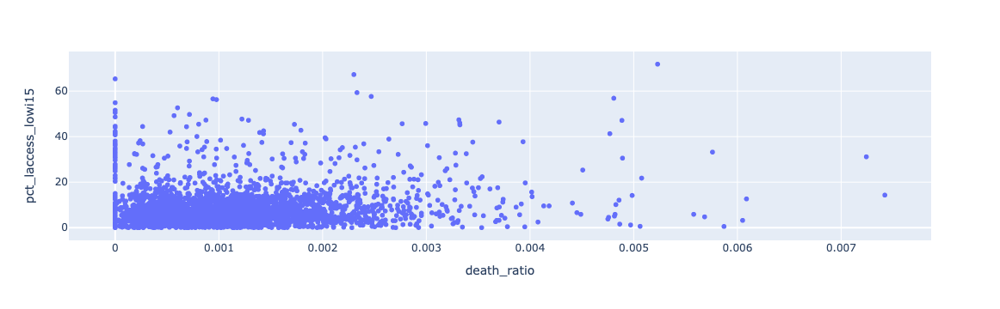

In [13]:
px.scatter(covid_cases_last_of_2020_and_low_income, x="death_ratio", y="pct_laccess_lowi15")

Visually we don't see any correlation between the variables. If we calculate the correlation, we also don't see a strong correlation either:

In [15]:
covid_cases_last_of_2020_and_low_income[["death_ratio", "pct_laccess_lowi15"]].corr(method="pearson")

,death_ratio,pct_laccess_lowi15
death_ratio,1.000000,0.115526
pct_laccess_lowi15,0.115526,1.000000


In [16]:
covid_cases_last_of_2020_and_low_income[["death_ratio", "pct_laccess_lowi15"]].corr(method="spearman")

,death_ratio,pct_laccess_lowi15
death_ratio,1.000000,0.094459
pct_laccess_lowi15,0.094459,1.000000


## Plot map

In [45]:
counties_geojson = requests.get("https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json").json()
    
    
def plot_usa_counties_map(dataframe, FIPS_column, color_column, color_column_label=None):
    if color_column_label is not None:
        labels={color_column: color_column_label}
    else:
        labels=None
        
    fig = px.choropleth_mapbox(
        dataframe,
        geojson=counties_geojson,
        locations=FIPS_column,
        color=color_column,
        color_continuous_scale="Viridis",
        mapbox_style="carto-positron",
        zoom=3, 
        center = {"lat": 37.0902, "lon": -95.7129},
        opacity=0.5,
        labels=labels
    )

    fig.update_layout(height=1000)

    fig.show()
    return fig


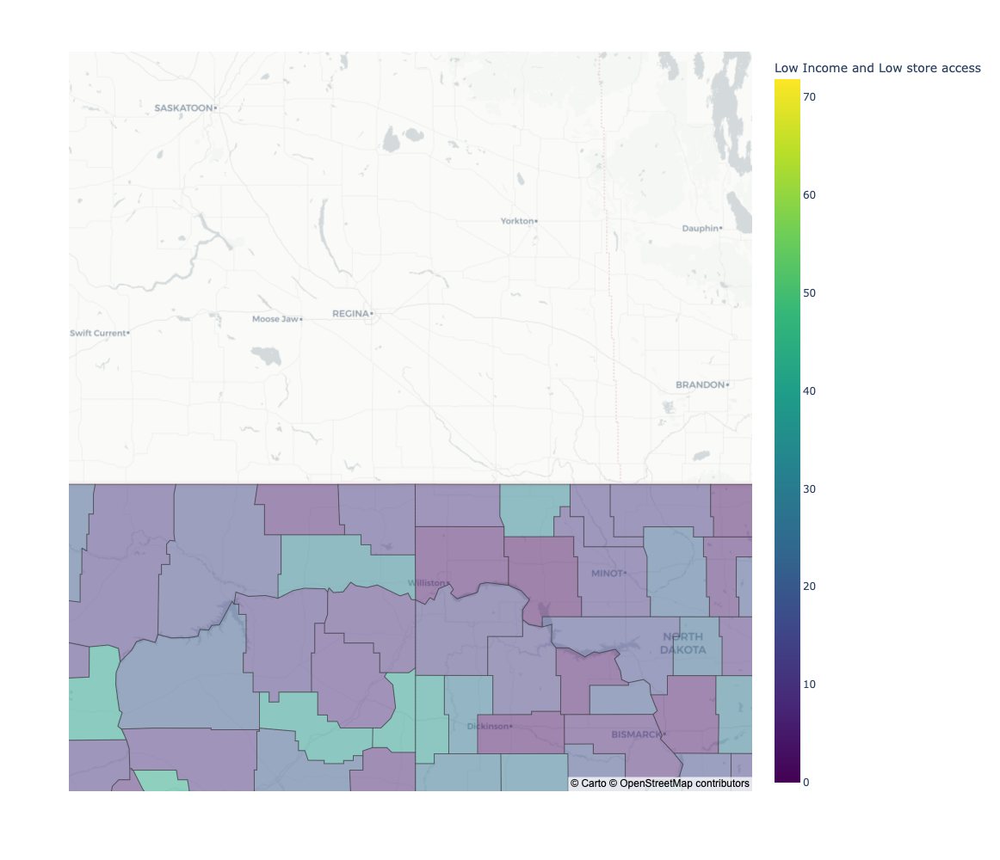

In [46]:
fig = plot_usa_counties_map(
    covid_cases_last_of_2020_and_low_income,
    "fips",
    "pct_laccess_lowi15",
    "Low Income and Low store access"
)

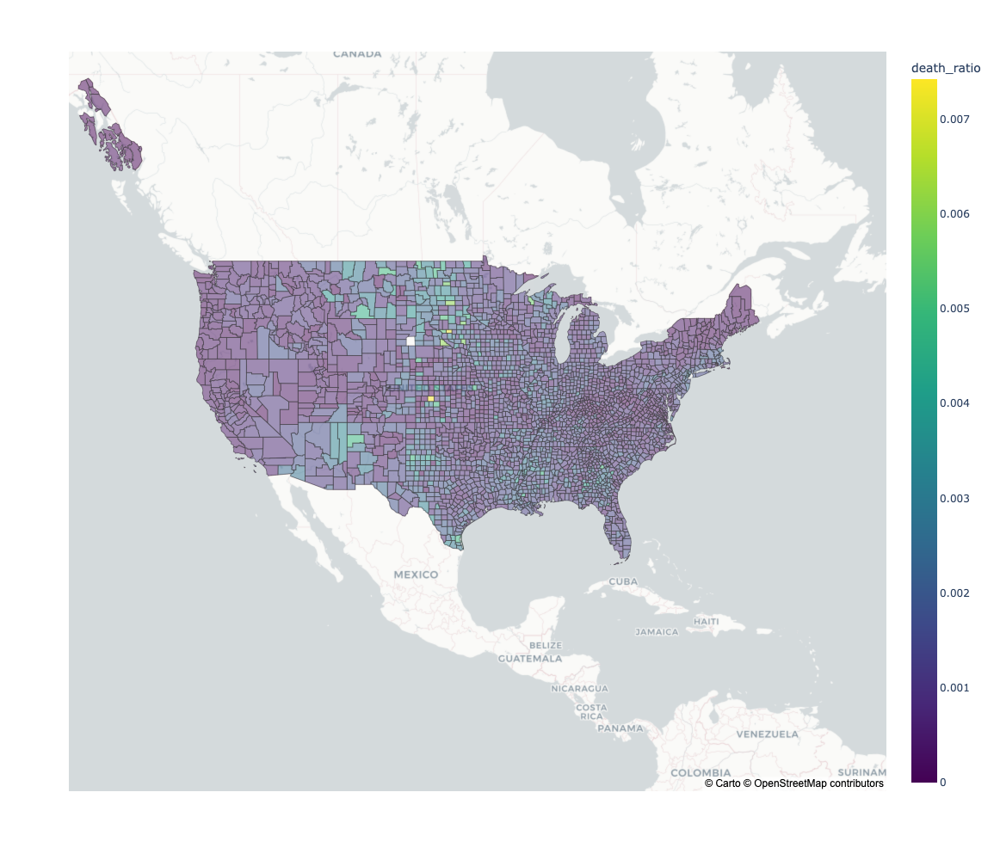

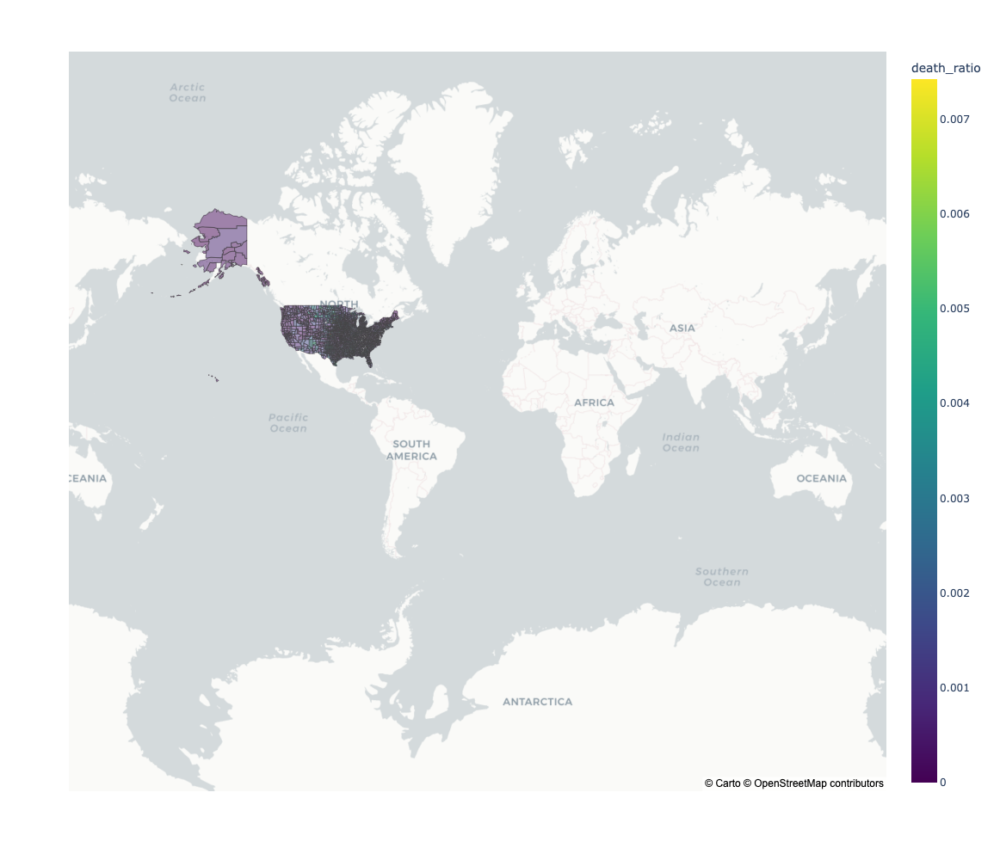

In [48]:
plot_usa_counties_map(
    covid_cases_last_of_2020_and_low_income,
    "fips",
    "death_ratio"
)

# Linear regression

In [ ]:
SELECT cc.fips, deaths / chd."2010_census_population" AS death_ratio, chd.pct_laccess_lowi15
    FROM covidcases AS cc
    JOIN countyhealthdata AS chd ON cc.fips = chd.fips
    WHERE date = '2020-12-31'

In [53]:
linear_regression_data = redshift_connector.execute_sql("""
    SELECT chd.*, cv.administered_dose1_pop_pct, cc.deaths / c.population AS death_ratio 
    FROM countyhealthdata AS chd
        JOIN county AS c ON chd.fips = c.fips
        JOIN covidcases AS cc ON cc.fips = chd.fips
        JOIN covidvaccination AS cv ON cv.fips = chd.fips AND cv.date = cc.date
    WHERE cc.date = '2020-12-31';
""")

In [59]:
import statsmodels.api as sm


In [78]:
linear_regression_data_clean = linear_regression_data.set_index("fips").fillna(0)
X = linear_regression_data_clean.drop("death_ratio", axis="columns")
y = linear_regression_data_clean["death_ratio"]

In [80]:
X2 = sm.add_constant(X)
est = sm.OLS(y, X2)
est2 = est.fit()
print(est2.summary())

                            OLS Regression Results                            
Dep. Variable:            death_ratio   R-squared:                       0.460
Model:                            OLS   Adj. R-squared:                  0.406
Method:                 Least Squares   F-statistic:                     8.571
Date:                Thu, 24 Nov 2022   Prob (F-statistic):          2.75e-225
Time:                        08:59:37   Log-Likelihood:                 18595.
No. Observations:                3133   AIC:                        -3.662e+04
Df Residuals:                    2849   BIC:                        -3.490e+04
Df Model:                         283                                         
Covariance Type:            nonrobust                                         
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const             

## Decision tree regressor

In [48]:
from sklearn.tree import DecisionTreeRegressor

decision_tree_regression_data = redshift_connector.execute_sql("""
    SELECT chd.*, cv.administered_dose1_pop_pct, cc.deaths / c.population AS death_ratio 
    FROM countyhealthdata AS chd
        JOIN county AS c ON chd.fips = c.fips
        JOIN covidcases AS cc ON cc.fips = chd.fips
        JOIN covidvaccination AS cv ON cv.fips = chd.fips AND cv.date = cc.date
    WHERE cc.date = '2020-12-31';
""")

decision_tree_regression_data_clean = decision_tree_regression_data.set_index("fips").fillna(0)
X = decision_tree_regression_data_clean.drop("death_ratio", axis="columns")
y = decision_tree_regression_data_clean["death_ratio"]

regressor = DecisionTreeRegressor(random_state = 0, max_depth=4) 
  
regressor.fit(X, y)

print(f"R-squared coefficient: {regressor.score(X, y)}")

print(f"Five most relevant features: {list(pd.Series(regressor.feature_importances_, index=X.columns).sort_values(ascending=False).index[:5])}")

R-squared coefficient: 0.29423978654363936
Five most relevant features: ['pct_loclfarm12', 'pch_sbp_12_17', 'pch_wicwomen_14_16', 'snap_oapp09', 'childpovrate15']


In [52]:
pd.Series(regressor.feature_importances_, index=X.columns).sort_values(ascending=False).iloc[:20]

pct_loclfarm12               0.291813
pch_sbp_12_17                0.148838
pch_wicwomen_14_16           0.113824
snap_oapp09                  0.073967
childpovrate15               0.062681
pch_wic_12_17                0.061469
pch_laccess_seniors_10_15    0.042643
pct_nhna10                   0.041149
snap_part_rate16             0.035294
pch_wicspth_11_16            0.031962
pc_fsrsales12                0.030530
orchard_acres12              0.027640
povrate15                    0.022537
specspth11                   0.013699
snaps12                      0.001954
pct_wicinfantchild16         0.000000
pch_cacfp_12_17              0.000000
pct_cacfp12                  0.000000
pct_wicwomen16               0.000000
pct_wic17                    0.000000
dtype: float64